# Training MS COCO images using Tensorflow
#### Source
https://www.tensorflow.org/tutorials/text/image_captioning

In [1]:
import seaborn as sns
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt

import re
import os
import time
import json
import pickle
import textwrap
import numpy as np
#from tqdm import tqdm

In [2]:
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0"

In [3]:
import tensorflow as tf
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow.python.client import device_lib

device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 15015474543868172914,
 name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 10823663144740456292
 physical_device_desc: "device: XLA_CPU device",
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 5984167527
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 16164182991897659634
 physical_device_desc: "device: 0, name: GeForce GTX 1060 6GB, pci bus id: 0000:03:00.0, compute capability: 6.1",
 name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 1882884292979687009
 physical_device_desc: "device: XLA_GPU device"]

### Seaborn and Matplotlib parameter tuning

In [4]:
# Set axtick dimensions
major_size = 6
major_width = 1.2
minor_size = 3
minor_width = 1
mpl.rcParams['xtick.major.size'] = major_size
mpl.rcParams['xtick.major.width'] = major_width
mpl.rcParams['xtick.minor.size'] = minor_size
mpl.rcParams['xtick.minor.width'] = minor_width
mpl.rcParams['ytick.major.size'] = major_size
mpl.rcParams['ytick.major.width'] = major_width
mpl.rcParams['ytick.minor.size'] = minor_size
mpl.rcParams['ytick.minor.width'] = minor_width

# Seaborn style settings
sns.set_style({'axes.axisbelow': True,
               'axes.edgecolor': '.1',
               'axes.facecolor': 'white',
               'axes.grid': True,
               'axes.labelcolor': '.15',
               'axes.spines.bottom': True,
               'axes.spines.left': True,
               'axes.spines.right': True,
               'axes.spines.top': True,
               'figure.facecolor': 'white',
               'font.family': ['sans-serif'],
               'font.sans-serif': ['Arial',
                'DejaVu Sans',
                'Liberation Sans',
                'Bitstream Vera Sans',
                'sans-serif'],
               'grid.color': '.8',
               'grid.linestyle': '--',
               'image.cmap': 'rocket',
               'lines.solid_capstyle': 'round',
               'patch.edgecolor': 'w',
               'patch.force_edgecolor': True,
               'text.color': '.15',
               'xtick.bottom': True,
               'xtick.color': '.15',
               'xtick.direction': 'in',
               'xtick.top': True,
               'ytick.color': '.15',
               'ytick.direction': 'in',
               'ytick.left': True,
               'ytick.right': True})

## Get training data and labels

In [5]:
annot_path = '/mnt/net/novo2/scratch/masterdesky/MS_COCO/annotations/captions_train2014.json'
train_path = '/mnt/net/novo2/scratch/masterdesky/MS_COCO/train2014/'
test_path = '/mnt/net/novo2/scratch/masterdesky/MS_COCO/test2015/'
test_own_path = './my_test_images/'

In [6]:
# Read the json file
with open(annot_path, 'r') as f:
    annotations = json.load(f)

# Store captions and image names in vectors
all_captions = []
all_img_name_vector = []

for annot in annotations['annotations']:
    caption = '<start> ' + annot['caption'] + ' <end>'
    image_id = annot['image_id']
    full_coco_image_path = train_path + 'COCO_train2014_' + '%012d.jpg' % (image_id)

    all_img_name_vector.append(full_coco_image_path)
    all_captions.append(caption)

# Shuffle captions and image_names together
# Set a random state
train_captions, img_name_vector = shuffle(all_captions,
                                          all_img_name_vector,
                                          random_state=1)

# Number of annotations choosen for the train-test split
# Select the first N captions from the shuffled set
# Set to 'None' to select all available data
num_examples = None
train_captions = train_captions[:num_examples]
img_name_vector = img_name_vector[:num_examples]

In [7]:
len(np.unique(all_img_name_vector))

82783

In [8]:
len(all_img_name_vector)

414113

In [9]:
(0.8 * 414113) / (414113 / 82783)

66226.40000000001

In [10]:
414113 / 82783

5.0023917954169335

## Preprocess on InceptionV3

In [11]:
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (299, 299))
    img = tf.keras.applications.inception_v3.preprocess_input(img)
    return img, image_path

### Initialize InceptionV3 and load the pretrained Imagenet weights

In [12]:
image_model = tf.keras.applications.InceptionV3(include_top=False,
                                                weights='imagenet')
new_input = image_model.input
hidden_layer = image_model.layers[-1].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

### Caching the features extracted from InceptionV3

In [13]:
# Get unique images
encode_train = sorted(set(img_name_vector))

# Feel free to change batch_size according to your system configuration
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(16)

In [16]:
with tf.device('/GPU:0'):
    for img, path in image_dataset:
        batch_features = image_features_extract_model(img)
        batch_features = tf.reshape(batch_features, 
                                    (batch_features.shape[0], -1, batch_features.shape[3]))

        for bf, p in zip(batch_features, path):
            path_of_feature = p.numpy().decode("utf-8")
            np.save(path_of_feature, bf.numpy())

In [14]:
def del_npys():
    content = os.listdir(train_path)
    content_npy = []
    content_jpg = []
    other = []
    for c in content:
        if c[-3:] == 'jpg':
            content_jpg.append(c)
        elif c[-3:] == 'npy':
            content_npy.append(c)
        else:
            other.append(c)

    for f in content_npy:
        os.unlink(train_path + f)

### Preprocess and tokenize the captions

In [17]:
# Find the maximum length of any caption in our dataset
def calc_max_length(tensor):
    return max(len(t) for t in tensor)

In [18]:
# Choose the top 5000 words from the vocabulary
top_k = 5000
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                  oov_token="<unk>",
                                                  filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
tokenizer.fit_on_texts(train_captions)

In [19]:
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

In [20]:
# Create the tokenized vectors
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [21]:
# Pad each vector to the max_length of the captions
# If you do not provide a max_length value, pad_sequences calculates it automatically
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [22]:
# Calculates the max_length, which is used to store the attention weights
max_length = calc_max_length(train_seqs)

### Split the data into training and testing

In [23]:
# Create training and validation sets using an 80-20 split
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,
                                                                    cap_vector,
                                                                    test_size=0.2,
                                                                    random_state=0)

In [24]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(331290, 331290, 82823, 82823)

In [119]:
np.save('./img_names_in_last_split/img_name_train', img_name_train)
np.save('./img_names_in_last_split/img_name_val', img_name_val)

## Hyperparameters

In [27]:
# Index of the last epoch
EPOCHS = 80

# Model parameters
BATCH_SIZE = 64
BUFFER_SIZE = 1000
embedding_dim = 256
units = 512
vocab_size = top_k + 1
num_steps = len(img_name_train) // BATCH_SIZE
# Shape of the vector extracted from InceptionV3 is (64, 2048)
# These two variables represent that vector shape
features_shape = 2048
attention_features_shape = 64

## Create a tf.data dataset for training

In [28]:
# Load the numpy files
def map_func(img_name, cap):
    img_tensor = np.load(img_name.decode('utf-8')+'.npy')
    return img_tensor, cap

In [29]:
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(map_func,
                                                             [item1, item2],
                                                             [tf.float32, tf.int32]),
                      num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

## Model

In [30]:
class BahdanauAttention(tf.keras.Model):
    def __init__(self, units):
        super(BahdanauAttention, self).__init__()
        self.W1 = tf.keras.layers.Dense(units)
        self.W2 = tf.keras.layers.Dense(units)
        self.V = tf.keras.layers.Dense(1)

    def call(self, features, hidden):
        # features(CNN_encoder output) shape == (batch_size, 64, embedding_dim)

        # hidden shape == (batch_size, hidden_size)
        # hidden_with_time_axis shape == (batch_size, 1, hidden_size)
        hidden_with_time_axis = tf.expand_dims(hidden, 1)

        # score shape == (batch_size, 64, hidden_size)
        score = tf.nn.tanh(self.W1(features) + self.W2(hidden_with_time_axis))

        # attention_weights shape == (batch_size, 64, 1)
        # you get 1 at the last axis because you are applying score to self.V
        attention_weights = tf.nn.softmax(self.V(score), axis=1)

        # context_vector shape after sum == (batch_size, hidden_size)
        context_vector = attention_weights * features
        context_vector = tf.reduce_sum(context_vector, axis=1)

        return context_vector, attention_weights

In [31]:
class CNN_Encoder(tf.keras.Model):
    # Since you have already extracted the features and dumped it using pickle
    # This encoder passes those features through a Fully connected layer
    def __init__(self, embedding_dim):
        super(CNN_Encoder, self).__init__()
        # shape after fc == (batch_size, 64, embedding_dim)
        self.fc = tf.keras.layers.Dense(embedding_dim)

    def call(self, x):
        x = self.fc(x)
        x = tf.nn.relu(x)
        return x

In [32]:
class RNN_Decoder(tf.keras.Model):
    def __init__(self, embedding_dim, units, vocab_size):
        super(RNN_Decoder, self).__init__()
        self.units = units

        self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
        self.gru = tf.keras.layers.GRU(self.units,
                                       return_sequences=True,
                                       return_state=True,
                                       recurrent_initializer='glorot_uniform')
        self.fc1 = tf.keras.layers.Dense(self.units)
        self.fc2 = tf.keras.layers.Dense(vocab_size)

        self.attention = BahdanauAttention(self.units)

    def call(self, x, features, hidden):
        # defining attention as a separate model
        context_vector, attention_weights = self.attention(features, hidden)

        # x shape after passing through embedding == (batch_size, 1, embedding_dim)
        x = self.embedding(x)

        # x shape after concatenation == (batch_size, 1, embedding_dim + hidden_size)
        x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)

        # passing the concatenated vector to the GRU
        output, state = self.gru(x)

        # shape == (batch_size, max_length, hidden_size)
        x = self.fc1(output)

        # x shape == (batch_size * max_length, hidden_size)
        x = tf.reshape(x, (-1, x.shape[2]))

        # output shape == (batch_size * max_length, vocab)
        x = self.fc2(x)

        return x, state, attention_weights

    def reset_state(self, batch_size):
        return tf.zeros((batch_size, self.units))

In [33]:
encoder = CNN_Encoder(embedding_dim)
decoder = RNN_Decoder(embedding_dim, units, vocab_size)

In [34]:
# Using Adam optimizer
optimizer = tf.keras.optimizers.Adam()

# Using sparse categorical crossentropy as loss
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')

def loss_function(real, pred):
    mask = tf.math.logical_not(tf.math.equal(real, 0))
    loss_ = loss_object(real, pred)

    mask = tf.cast(mask, dtype=loss_.dtype)
    loss_ *= mask

    return tf.reduce_mean(loss_)

## Checkpoint management

In [42]:
checkpoint_path = './checkpoints/train'
ckpt = tf.train.Checkpoint(encoder=encoder,
                           decoder=decoder,
                           optimizer=optimizer)
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

In [43]:
start_epoch = 0
if ckpt_manager.latest_checkpoint:
    start_epoch = int(ckpt_manager.latest_checkpoint.split('-')[-1])
    # restoring the latest checkpoint in checkpoint_path
    ckpt.restore(ckpt_manager.latest_checkpoint)

## Training

In [44]:
# adding this in a separate cell because if you run the training cell
# many times, the loss_plot array will be reset
loss_plot = []

In [45]:
@tf.function
def train_step(img_tensor, target):
    loss = 0

    # initializing the hidden state for each batch
    # because the captions are not related from image to image
    hidden = decoder.reset_state(batch_size=target.shape[0])

    dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * target.shape[0], 1)

    with tf.GradientTape() as tape:
        features = encoder(img_tensor)

        for i in range(1, target.shape[1]):
            # passing the features through the decoder
            predictions, hidden, _ = decoder(dec_input, features, hidden)

            loss += loss_function(target[:, i], predictions)

            # using teacher forcing
            dec_input = tf.expand_dims(target[:, i], 1)

    total_loss = (loss / int(target.shape[1]))

    trainable_variables = encoder.trainable_variables + decoder.trainable_variables

    gradients = tape.gradient(loss, trainable_variables)

    optimizer.apply_gradients(zip(gradients, trainable_variables))

    return loss, total_loss

In [ ]:
with tf.device('/GPU:0'):
    for epoch in range(start_epoch, EPOCHS):
        start = time.time()
        total_loss = 0

        for (batch, (img_tensor, target)) in enumerate(dataset):
            batch_loss, t_loss = train_step(img_tensor, target)
            total_loss += t_loss

            if batch % 100 == 0:
                print ('Epoch {} Batch {} Loss {:.4f}'.format(
                  epoch + 1, batch, batch_loss.numpy() / int(target.shape[1])))
        # storing the epoch end loss value to plot later
        loss_plot.append(total_loss / num_steps)

        if (epoch+1) % 5 == 0:
            ckpt_manager.save(checkpoint_number=epoch+1)

        print ('Epoch {} Loss {:.6f}'.format(epoch + 1,
                                             total_loss/num_steps))
        print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))

Epoch 1 Batch 0 Loss 1.8164
Epoch 1 Batch 100 Loss 1.0219
Epoch 1 Batch 200 Loss 0.9085
Epoch 1 Batch 300 Loss 0.7980
Epoch 1 Batch 400 Loss 0.8159
Epoch 1 Batch 500 Loss 0.7193
Epoch 1 Batch 600 Loss 0.7265
Epoch 1 Batch 700 Loss 0.6969
Epoch 1 Batch 800 Loss 0.7515
Epoch 1 Batch 900 Loss 0.7260
Epoch 1 Batch 1000 Loss 0.6889
Epoch 1 Batch 1100 Loss 0.6748
Epoch 1 Batch 1200 Loss 0.6386
Epoch 1 Batch 1300 Loss 0.6786
Epoch 1 Batch 1400 Loss 0.6441
Epoch 1 Batch 1500 Loss 0.6736
Epoch 1 Batch 1600 Loss 0.6329
Epoch 1 Batch 1700 Loss 0.6460
Epoch 1 Batch 1800 Loss 0.6922
Epoch 1 Batch 1900 Loss 0.6461
Epoch 1 Batch 2000 Loss 0.6663
Epoch 1 Batch 2100 Loss 0.7556
Epoch 1 Batch 2200 Loss 0.6227


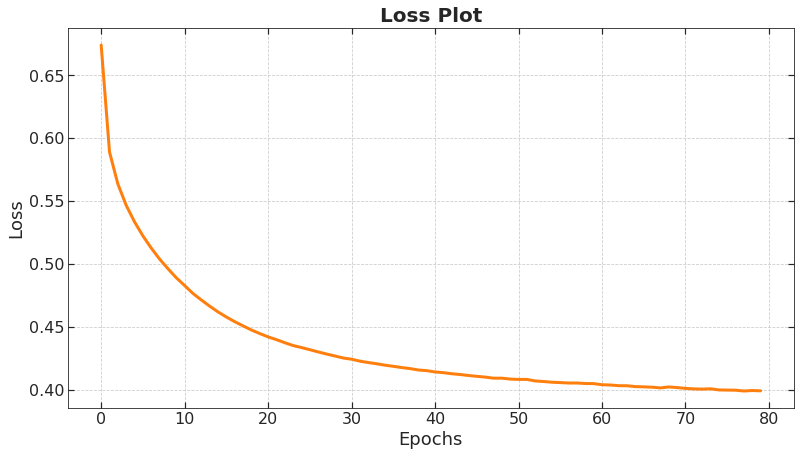

In [47]:
fig, axes = plt.subplots(figsize=(13,7))

axistitlesize = 20
axislabelsize = 18
axisticksize = 16

axes.plot(loss_plot,
          color='tab:orange', lw=3)

axes.set_title('Loss Plot', fontsize=axistitlesize, fontweight='bold')
axes.set_xlabel('Epochs', fontsize=axislabelsize)
axes.set_ylabel('Loss', fontsize=axislabelsize)

axes.tick_params(axis='both', which='major', labelsize=axisticksize)

plt.savefig('./out/loss_e-{0}_tr-{1}.png'.format(EPOCHS, len(img_name_train)))

plt.show()

## Captioning

In [48]:
def evaluate(image):
    attention_plot = np.zeros((max_length, attention_features_shape))

    hidden = decoder.reset_state(batch_size=1)

    temp_input = tf.expand_dims(load_image(image)[0], 0)
    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

    features = encoder(img_tensor_val)

    dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
    result = []

    for i in range(max_length):
        predictions, hidden, attention_weights = decoder(dec_input, features, hidden)

        attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()

        predicted_id = tf.random.categorical(predictions, 1)[0][0].numpy()
        result.append(tokenizer.index_word[predicted_id])

        if tokenizer.index_word[predicted_id] == '<end>':
            return result, attention_plot

        dec_input = tf.expand_dims([predicted_id], 0)

    attention_plot = attention_plot[:len(result), :]
    return result, attention_plot

In [49]:
def plot_attention(image, result, attention_plot, save=True):
    temp_image = np.array(plt.imread(image))

    # Number of tokens in the current prediction
    # That's how many subplots will be created
    len_result = len(result)
    
    # Create a figure with subplots in a 2D square grid
    nrows = int(np.ceil(np.sqrt(len_result)))
    ncols = int(np.ceil(np.sqrt(len_result)))
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols*8, ncols*8))
    
    att_w = 8
    att_h = 8
    axistitlesize = 20
    
    for l in range(len_result):
        ax = axes[l//ncols][l%ncols]
        temp_att = np.resize(attention_plot[l], (att_h, att_w))
        img = ax.imshow(temp_image)
        ax.set_title(result[l], fontsize=axistitlesize, fontweight='bold')
        ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())
        
        # Mark the grid of the attention plot
        img_w = temp_image.shape[1]
        img_h = temp_image.shape[0]
        ax.set_xticks([img_w/att_w * i for i in range(att_w+1)])
        ax.set_xticklabels([])
        ax.set_yticks([img_h/att_h * i for i in range(att_h+1)])
        ax.set_yticklabels([])
        
    for n in range(len_result, nrows*ncols):
        ax = axes[n//ncols][n%ncols]
        ax.axis('off')
    
    if save:
        plt.savefig('./img/{0}_e-{1}_tr-{2}_attention.png'.format(image[-16:-4], EPOCHS, len(img_name_train)))
    
    plt.tight_layout()
    plt.show()

### Test image from the validation set

In [112]:
# captions on the validation set
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

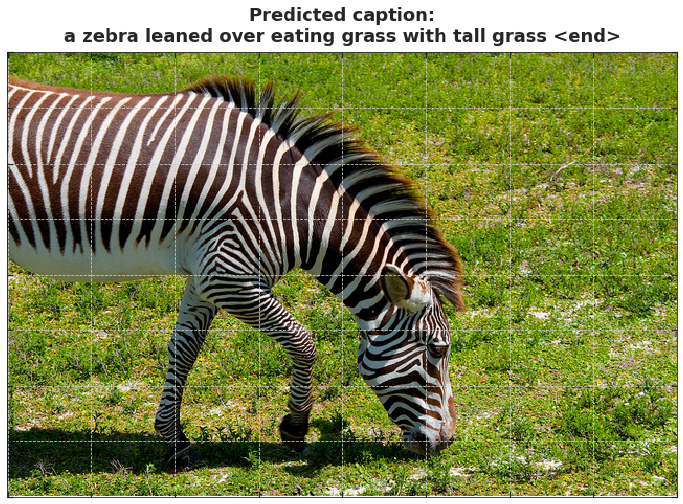

In [113]:
fig, axes = plt.subplots(figsize=(12,12))

axes.set_aspect('equal')

axistitlesize = 18
axislabelsize = 18
axisticksize = 16

temp_image = plt.imread(image)
img = axes.imshow(temp_image)

pred_cap = ' '.join(result)
pred_cap = '\n'.join(textwrap.wrap(pred_cap, 80))
axes.set_title('Predicted caption:\n' + pred_cap, fontsize=axistitlesize, fontweight='bold',
               pad=10)

# Mark the grid of the attention plot
att_w = 8
att_h = 8

img_w = temp_image.shape[1]
img_h = temp_image.shape[0]
axes.set_xticks([img_w/att_w * i for i in range(att_w+1)])
axes.set_xticklabels([])
axes.set_yticks([img_h/att_h * i for i in range(att_h+1)])
axes.set_yticklabels([])

axes.tick_params(axis='both', which='major', labelsize=axisticksize)

plt.savefig('./img/{0}_e-{1}_tr-{2}.png'.format(image[-16:-4], EPOCHS, len(img_name_train)))

plt.show()

Real Caption: <start> a kid on his bed with so many dolls besides <end>
Prediction Caption: a zebra leaned over eating grass with tall grass <end>


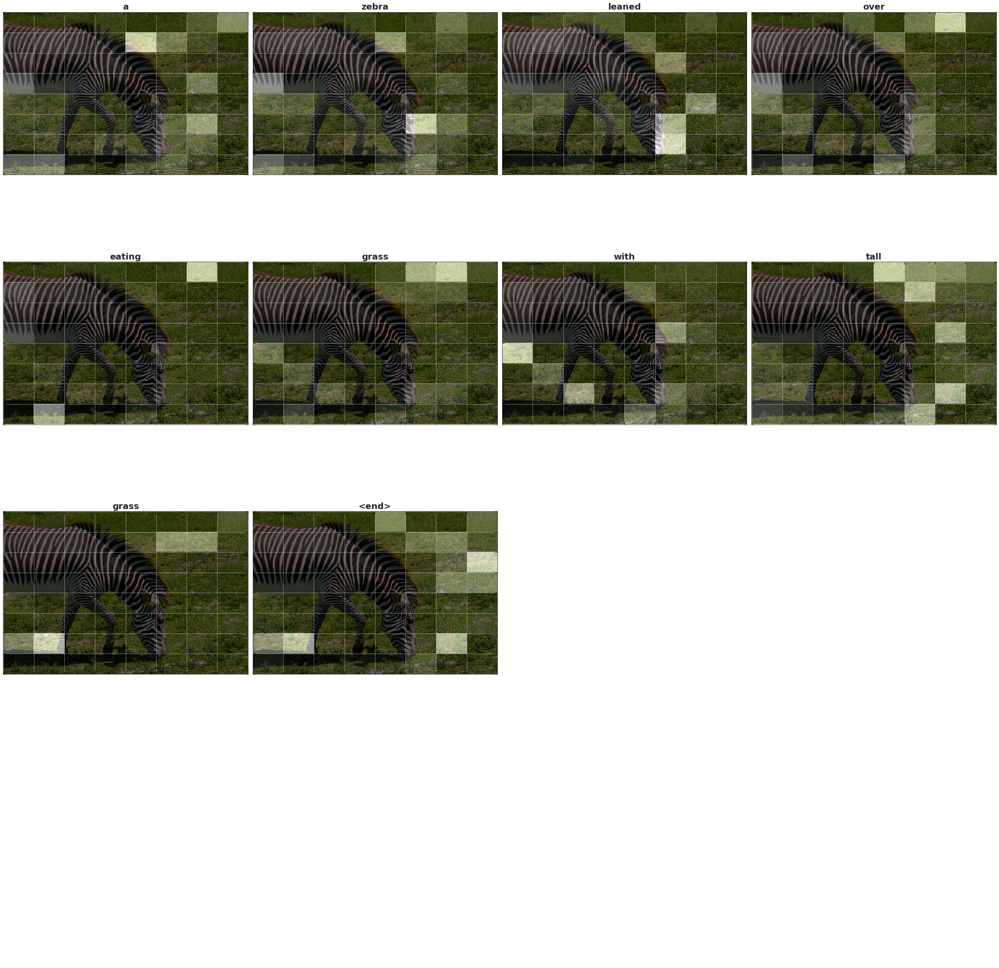

In [114]:
print ('Real Caption:', real_caption)
print ('Prediction Caption:', ' '.join(result))
plot_attention(image, result, attention_plot)

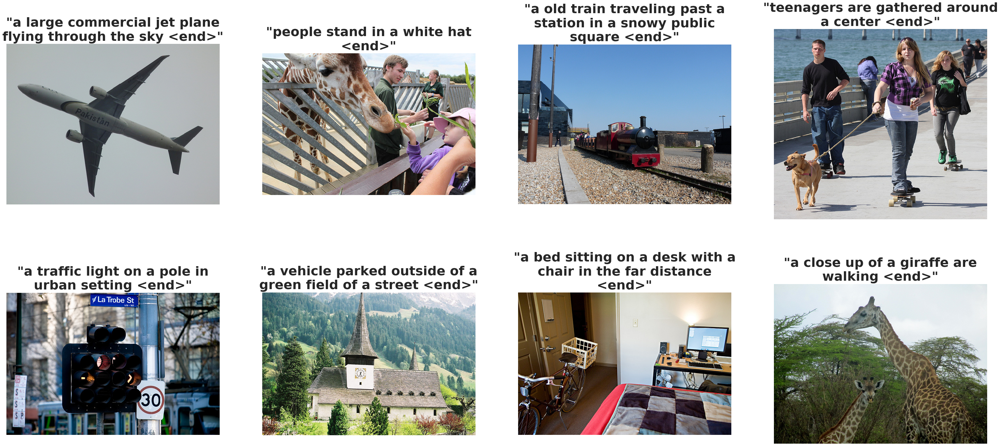

In [161]:
save = True
nrows = 2
ncols = 4
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols*13, nrows*13))
fig.subplots_adjust(hspace=0.01)

axistitlesize = 38

imgs_yet = 0
while imgs_yet < nrows*ncols:    
    
    # Choose random image
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]
    temp_image = np.array(plt.imread(image))

    if temp_image.shape[1] > temp_image.shape[0] and temp_image.shape[1] < 1.5 * temp_image.shape[0]:
        real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
        result, _ = evaluate(image)

        ax = axes[imgs_yet//ncols][imgs_yet%ncols]
        ax.set_aspect('equal')
        ax.axis('off')

        # Show image
        img = ax.imshow(temp_image)

        # Write caption
        pred_cap = ' '.join(result)
        pred_cap = '\n'.join(textwrap.wrap(pred_cap, 30))
        ax.set_title('\"' + pred_cap + '\"', fontsize=axistitlesize, fontweight='bold',
                     pad=10)
        
        imgs_yet += 1

#fig.tight_layout()
        
if save:
    plt.savefig('./img/sample_predicts/sample_predicts_e-{0}_tr-{1}.png'.format(EPOCHS,
                                                                                len(img_name_train)),
                bbox_inches='tight')
plt.show()

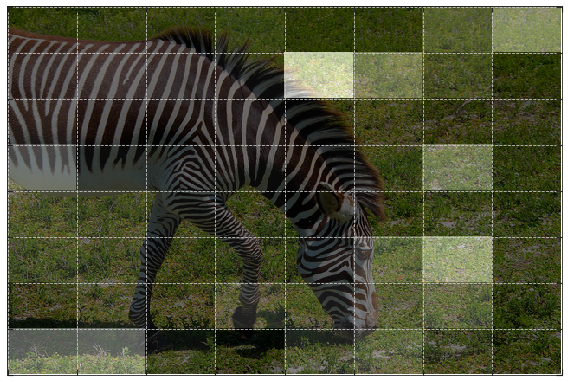

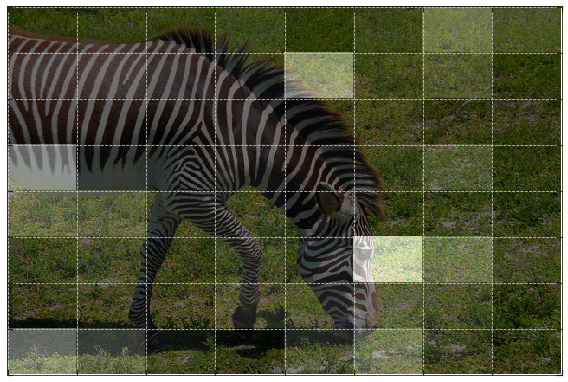

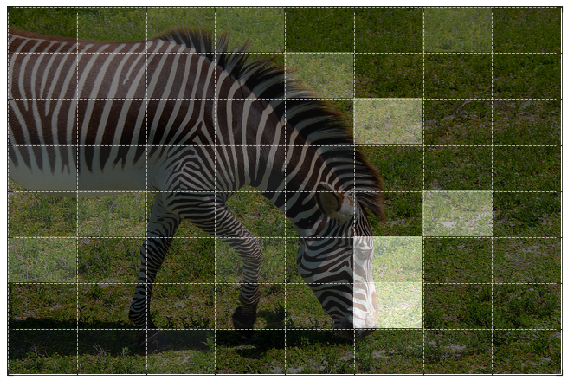

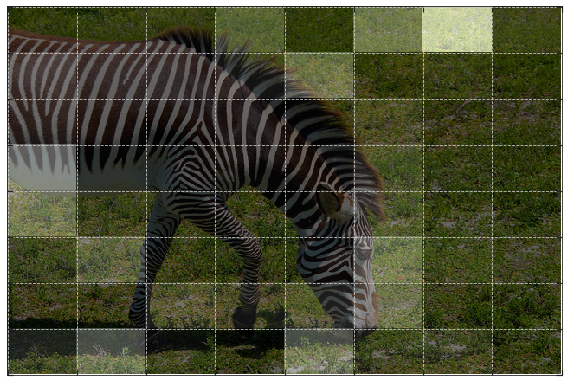

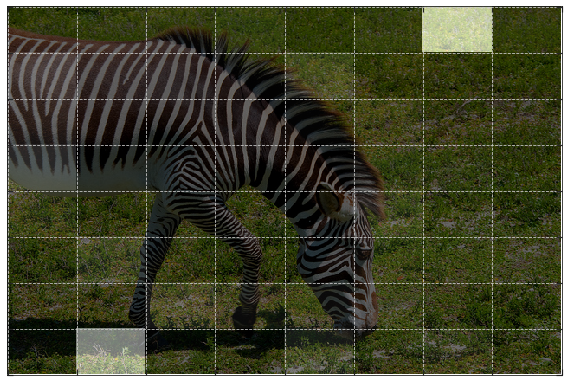

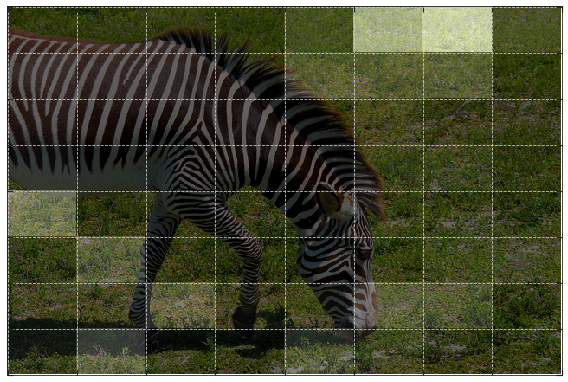

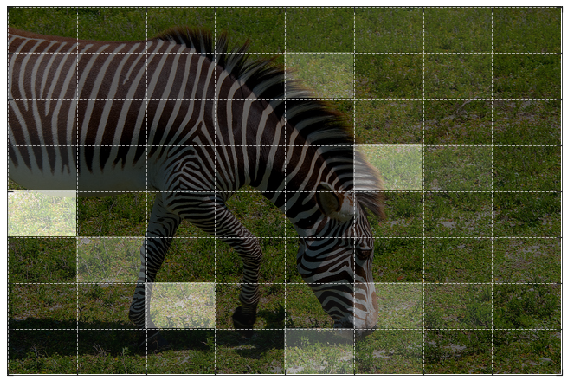

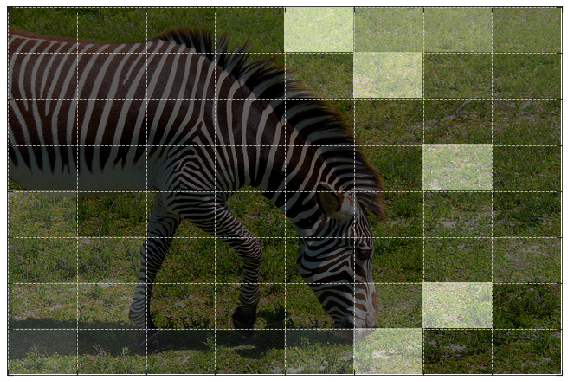

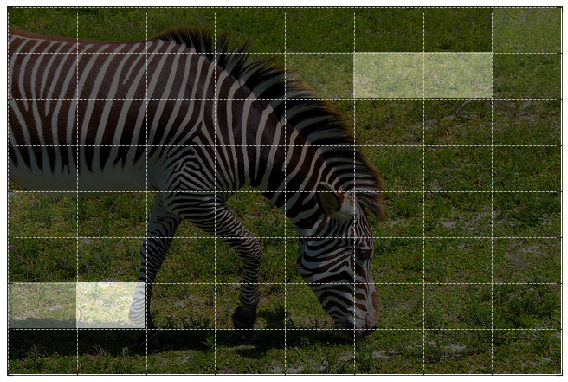

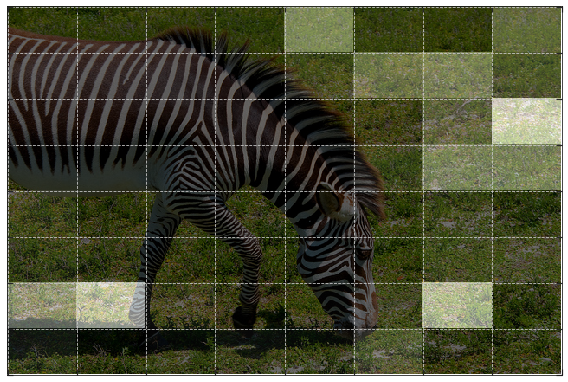

In [116]:
temp_image = np.array(plt.imread(image))

# Number of tokens in the current prediction
# That's how many subplots will be created
len_result = len(result)

att_w = 8
att_h = 8
axistitlesize = 20

for l in range(len_result):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(1*8, 1*8))
    
    temp_att = np.resize(attention_plot[l], (att_h, att_w))
    img = ax.imshow(temp_image)
    #ax.set_title(result[l], fontsize=axistitlesize, fontweight='bold')
    ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())

    # Mark the grid of the attention plot
    img_w = temp_image.shape[1]
    img_h = temp_image.shape[0]
    ax.set_xticks([img_w/att_w * i for i in range(att_w+1)])
    ax.set_xticklabels([])
    ax.set_yticks([img_h/att_h * i for i in range(att_h+1)])
    ax.set_yticklabels([])

    fig.tight_layout()
    
    plt.savefig('./img/{0}_e-{1}_tr-{2}_attention_{3}.png'.format(image[-16:-4], EPOCHS, len(img_name_train), l),
                bbox_inches='tight')

### Own test image

In [95]:
os.listdir(test_own_path)

['.ipynb_checkpoints', 'image_002.jpg', 'image_000.jpg', 'image_001.jpg']

In [108]:
image_path = test_own_path + os.listdir(test_own_path)[3]
result, attention_plot = evaluate(image_path)

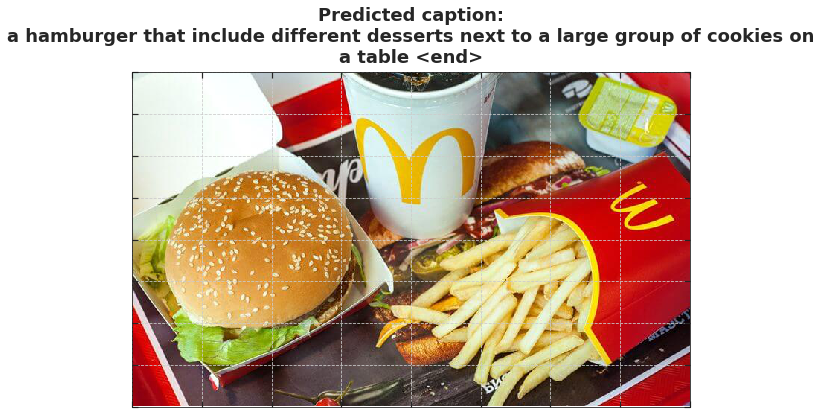

In [109]:
fig, axes = plt.subplots(figsize=(10,10))

axes.set_aspect('equal')

axistitlesize = 18
axislabelsize = 18
axisticksize = 16

temp_image = plt.imread(image_path)
img = axes.imshow(temp_image)

pred_cap = ' '.join(result)
pred_cap = '\n'.join(textwrap.wrap(pred_cap, 80))
axes.set_title('Predicted caption:\n' + pred_cap, fontsize=axistitlesize, fontweight='bold',
               pad=10)

# Mark the grid of the attention plot
att_w = 8
att_h = 8

img_w = temp_image.shape[1]
img_h = temp_image.shape[0]
axes.set_xticks([img_w/att_w * i for i in range(att_w+1)])
axes.set_xticklabels([])
axes.set_yticks([img_h/att_h * i for i in range(att_h+1)])
axes.set_yticklabels([])

axes.tick_params(axis='both', which='major', labelsize=axisticksize)

plt.show()

Predicted caption: a hamburger that include different desserts next to a large group of cookies on a table <end>


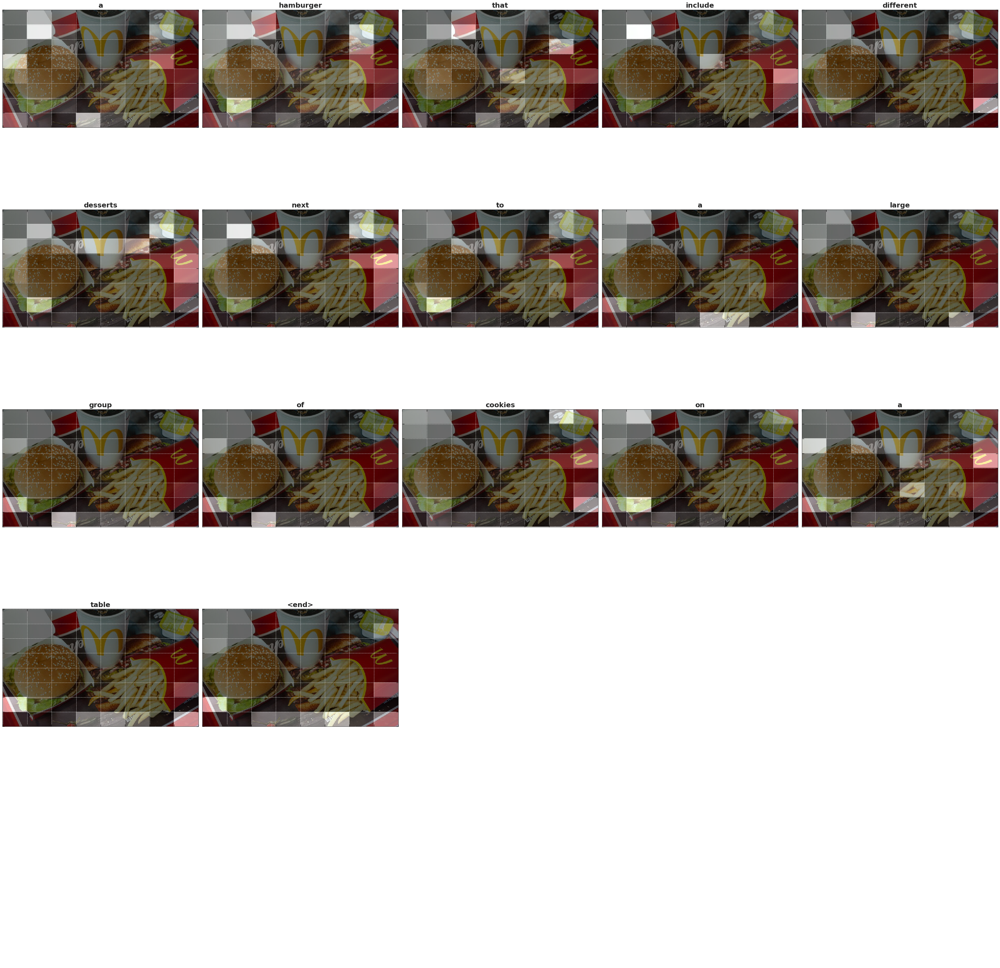

In [110]:
print ('Predicted caption:', ' '.join(result))
plot_attention(image_path, result, attention_plot, save=False)